```
① FL(Flawless): 무결점으로 내부나 외부에 흠이 하나 없다.
② IF(Internally Flawless): 내부엔 흠이 없으나 외부에는 흠이 조금 있다.
③ VVS(Very Very Slightly): 내부에 흠이 있으나 10배 확대시 전문가도 발견하기 어려운 정도.
④ VS(Very Slightly): 내부에 흠이 있으나 10배 확대시 일반인이 발견하기 어려운 정도.
⑤ SI(Slightly Included): 내부에 흠이 10배 확대시 일반인도 쉽게 찾을 수 있는 정도.
⑥ I(Included): 내부의 흠이 10배 확대시에 눈으로 보이는 정도. 판매상이 권하지 않는 등급.

출처: https://lsk.pe.kr/3476 [風林火山]
```

In [1]:
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

%matplotlib inline

In [2]:
df = sns.load_dataset("diamonds")
df

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype   
---  ------   --------------  -----   
 0   carat    53940 non-null  float64 
 1   cut      53940 non-null  category
 2   color    53940 non-null  category
 3   clarity  53940 non-null  category
 4   depth    53940 non-null  float64 
 5   table    53940 non-null  float64 
 6   price    53940 non-null  int64   
 7   x        53940 non-null  float64 
 8   y        53940 non-null  float64 
 9   z        53940 non-null  float64 
dtypes: category(3), float64(6), int64(1)
memory usage: 3.0 MB


In [4]:
df.describe()

,carat,depth,table,price,x,y,z
count,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000
mean,0.797940,61.749405,57.457184,3932.799722,5.731157,5.734526,3.538734
std,0.474011,1.432621,2.234491,3989.439738,1.121761,1.142135,0.705699
min,0.200000,43.000000,43.000000,326.000000,0.000000,0.000000,0.000000
25%,0.400000,61.000000,56.000000,950.000000,4.710000,4.720000,2.910000
50%,0.700000,61.800000,57.000000,2401.000000,5.700000,5.710000,3.530000
75%,1.040000,62.500000,59.000000,5324.250000,6.540000,6.540000,4.040000
max,5.010000,79.000000,95.000000,18823.000000,10.740000,58.900000,31.800000


In [5]:
df.describe(exclude="number")

,cut,color,clarity
count,53940,53940,53940
unique,5,7,8
top,Ideal,G,SI1
freq,21551,11292,13065


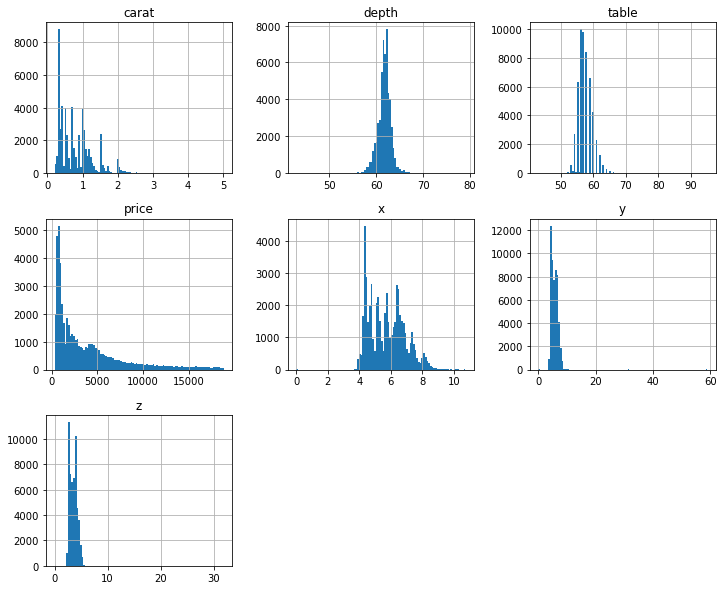

In [6]:
df.hist(figsize=(12, 10), bins=100)
plt.show()

In [7]:
df_num = df.select_dtypes(include="number")
df_num.columns.name = "cols"

In [24]:
px.histogram(df_num, facet_col="cols", facet_col_wrap=2, nbins=50)

In [23]:
px.histogram(df_num[["x", "y", "z"]], facet_col="cols", facet_col_wrap=2, nbins=50)

In [9]:
px.histogram(df, x="price", title="price")

In [10]:
px.histogram(df, x="cut", y="price", histfunc="sum")

In [11]:
px.histogram(df, x="cut", y="price", histfunc="avg")

In [12]:
cut_count = df["cut"].value_counts()
cut_count

Ideal        21551
Premium      13791
Very Good    12082
Good          4906
Fair          1610
Name: cut, dtype: int64

<AxesSubplot:>

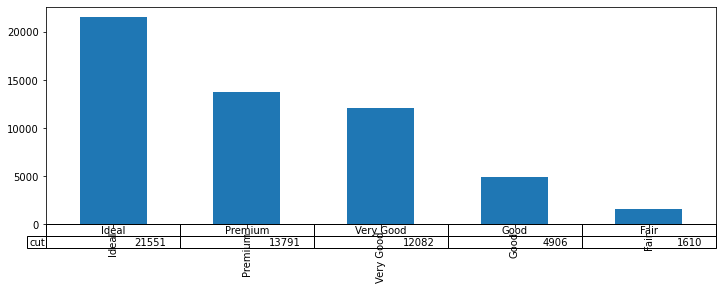

In [13]:
cut_count.plot.bar(table=True, figsize=(12, 4))

In [14]:
px.histogram(df, x="cut", histfunc="count")

In [15]:
px.histogram(df, x="color", histfunc="count")

In [16]:
px.histogram(df, x="color", histfunc="count", color="cut")

In [17]:
px.histogram(df, x="color", histfunc="count", color="cut", facet_col="cut")

In [18]:
px.histogram(df, x="clarity", histfunc="count", color="cut", facet_col="cut")

In [19]:
px.scatter_matrix(df, color="cut", height=1000)

In [20]:
df

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74
